# Tennessee eastman fault detection with pca and lgb

Unsupervised learning for anomaly detection

## Import Library and data

In [ ]:
#Imports
import os
import platform
import subprocess
from pathlib import Path

FIRST_RUN_MARKER: Path = Path.home() / ".firstrun_complete"

if not FIRST_RUN_MARKER.exists():
    if platform.system() != "Windows":
        subprocess.run(["brew", "install", "libomp"], check=True)

    subprocess.run(["pip", "install", "-r", "requirements.txt"], check=True)

    FIRST_RUN_MARKER.touch()

import pyreadr
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import scipy.stats
import sklearn.decomposition
import sklearn.preprocessing
import lightgbm as lgb

print(np.__version__)
print(pd.__version__)
print(matplotlib.__version__)
print(scipy.__version__)
print(sklearn.__version__)
print(lgb.__version__)


2.1.3
2.3.1
3.10.3
1.16.0
1.7.0
4.6.0


In [2]:
train_normal_path = 'data/TEP_FaultFree_Training.RData'
train_faulty_path = 'data/TEP_Faulty_Training.RData'

test_normal_path = 'data/TEP_FaultFree_Testing.RData'
test_faulty_path = 'data/TEP_Faulty_Testing.RData'

df_ff_train = pyreadr.read_r(train_normal_path)['fault_free_training']
df_f_train = pyreadr.read_r(train_faulty_path)['faulty_training']

df_ff_test = pyreadr.read_r(test_normal_path)['fault_free_testing']
df_f_test = pyreadr.read_r(test_faulty_path)['faulty_testing']

# Principal Component Analysis

The Principal Component Analysis (PCA) technique applies a linear transformation to generate an orthogonal set of linear combinations of the original variables, whose directions are called principal components, with the aim of selecting a subset of these variables that appropriately summarizes the data variability.

When PCA is applied to detect faults, the principal components are identified using the training data; the principal components found during the training are also expected to explain the variability of the test data. If this is not the case, the process is considered to be faulty.

In [26]:
# PCA
# .fit_transform(X) learns principal components and projects X into reduced space;
# .transform(X) projects new data using learned components;
# .inverse_transform(…) reconstructs data from PCA space;
# together, they enable encoding-decoding to detect deviations via reconstruction error (SPE).


class ModelPCA:
    """
    Principal Component Analysis (PCA)-based model for process monitoring using Squared Prediction Error (SPE).

    This model performs unsupervised anomaly detection by reconstructing input data using PCA and
    measuring the reconstruction error (SPE). Designed for use with standardized multivariate time series
    or process variables.

    Attributes:
        mu_train (np.ndarray): Mean vector of the training data.
        std_train (np.ndarray): Standard deviation vector of the training data.
        m (sklearn.decomposition.PCA): Trained PCA model.
    """

    def spe(self, X: np.ndarray, X_pred: np.ndarray) -> np.ndarray:
        return np.sum((X - X_pred)**2, axis=1)

    def train(self, df_train: np.ndarray, plot: bool = False) -> np.ndarray:
        # Column-wise means and standard deviations for training data
        self.mu_train = df_train.mean(axis=0)
        self.std_train = df_train.std(axis=0)
        #  Standardize data to zero mean, unit variance.
        X_train = ((df_train - self.mu_train) / self.std_train).astype(float)

        self.m = sklearn.decomposition.PCA(n_components=0.9)
        transformed = self.m.fit_transform(X_train)

        print(
            f"The shape of the training data: {X_train.shape} which means {X_train.shape[0]} samples and {X_train.shape[1]} features."
        )
        print(f"Number of components selected: {self.m.n_components_}")

        X_train_pred = self.m.inverse_transform(transformed)

        if plot:
            fig, ax = plt.subplots()
            fig.suptitle("Training PCA", fontsize=16)
            xaxis = np.arange(len(self.m.explained_variance_ratio_))
            ax.bar(xaxis, self.m.explained_variance_ratio_)
            ax.plot(xaxis, np.cumsum(self.m.explained_variance_ratio_))
            ax.set_title('PCA - Explained variance')

        return self.spe(X_train, X_train_pred)

    # def test(self, df_test: np.ndarray, plot: bool = False) -> np.ndarray:
    #     # Standardize test data using training statistics
    #     X_test = ((df_test - self.mu_train) / self.std_train).astype(float)
    #     # Transform test data using the trained PCA model
    #     X_test_transformed = self.m.transform(X_test)
    #     # Reconstruct test data from PCA space
    #     X_test_pred = self.m.inverse_transform(X_test_transformed)
    #     # Calculate Squared Prediction Error (SPE)
    #     return self.spe(X_test, X_test_pred)

    def test(self, df_test: np.ndarray, plot: bool = False) -> np.ndarray:
        # Standardize test data using training statistics
        if isinstance(df_test, pd.DataFrame):
            X_test = (df_test - self.mu_train) / self.std_train
            X_test = X_test.astype(float)
        else:
            X_test = ((df_test - self.mu_train) / self.std_train).astype(float)
            X_test = pd.DataFrame(X_test)

        # Transform test data using the trained PCA model
        X_test_transformed = self.m.transform(X_test)
        # Reconstruct test data from PCA space
        X_test_pred = self.m.inverse_transform(X_test_transformed)
        X_test_pred = pd.DataFrame(X_test_pred,
                                   columns=X_test.columns,
                                   index=X_test.index)

        # Calculate Squared Prediction Error (SPE)
        spe = self.spe(X_test.values, X_test_pred.values)

        if plot:
            print("PCA plotting is enabled")
            n_cols: int = 4
            n_features: int = len(X_test.columns)
            n_rows: int = int(np.ceil(n_features / n_cols))

            fig, ax = plt.subplots(n_rows, n_cols, figsize=(30, 4 * n_rows))
            ax = ax.ravel()

            for i, col in enumerate(X_test.columns):
                ts_real = X_test[col].values
                ts_pred = X_test_pred[col].values
                ax[i].plot(ts_real, label='Original')
                ax[i].plot(ts_pred, label='Reconstructed', alpha=0.6)
                ax[i].set_title(
                    f'{col} | SPE mean: {np.mean((ts_real - ts_pred) ** 2):.4f}'
                )
                ax[i].legend()

            # Hide unused subplots
            for j in range(i + 1, len(ax)):
                ax[j].axis('off')

            fig.suptitle(
                "PCA Reconstruction - Original vs Reconstructed (Standardized)",
                fontsize=16)
            plt.tight_layout(rect=[0, 0, 1, 0.96])

        return spe


# Light Gradient Boosting

Light Gradient Boosting is a tree-based algorithm that groups simple decision tree models using the boosting strategy, in which trees are trained sequentially and each one tries to correct the error of the previous tree.

Here we will use a strategy proposed by [Sergei Averkiev](https://kaggle.com/averkij/anomaly-detection-methods), in which each feature is predicted using the remaining features as predictors. The fault is detected when the mean squared error of all predictions exceeds a certain limit.

In [27]:
# LightGBM-based model for process monitoring using Squared Prediction Error (SPE).
# as proposed by Sergei Averkiev (kaggle.com/averkij/anomaly-detection-methods)


class ModelEnsembleRegressors():

    def __init__(self, regressor, **kwargs):
        self.regressor = regressor
        self.kwargs = kwargs

    def spe(self, y, y_pred):
        return (y - y_pred)**2

    def train(self, df_train, plot=False):
        self.mu_train = df_train.mean(axis=0)
        self.std_train = df_train.std(axis=0)

        self.models = {}
        spe_df = pd.DataFrame()

        self.to_predict_test = []

        if plot:
            n_rows = int(np.ceil(len(df_train.columns) / 4))
            fig, ax = plt.subplots(n_rows, 4, figsize=(30, 4 * n_rows))
            fig.suptitle("Training LGB", fontsize=16)
        for i, col in enumerate(df_train.columns):
            model = self.regressor(**self.kwargs)

            # Original:
            # tr_x = sklearn.preprocessing.scale(df_train.drop([col], axis=1))
            # tr_y = sklearn.preprocessing.scale(df_train[col])

            # Fixed: retain DataFrame structure with column names
            tr_x_df = df_train.drop([col], axis=1)
            tr_x_scaled = sklearn.preprocessing.scale(tr_x_df)
            tr_x = pd.DataFrame(tr_x_scaled,
                                columns=tr_x_df.columns,
                                index=tr_x_df.index)

            tr_y_series = df_train[col]
            tr_y_scaled = sklearn.preprocessing.scale(
                tr_y_series.values.reshape(-1, 1)).flatten()
            tr_y = pd.Series(tr_y_scaled, index=tr_y_series.index)

            model.fit(X=tr_x, y=tr_y)
            tr_y_pred = model.predict(X=tr_x)

            self.models[col] = model
            spe_df[col] = self.spe(tr_y, tr_y_pred)

            self.to_predict_test.append(col)

            if plot:
                ax.ravel()[i].plot(tr_y)
                ax.ravel()[i].plot(tr_y_pred, alpha=0.5)
                ax.ravel()[i].set_title(
                    f'{col} - SPE = {np.mean(spe_df[col]):.2f}')

        return np.mean(spe_df, axis=1)

    def test(self, df_test, plot=False):
        spe_df = pd.DataFrame()

        if plot:
            print("LGB Ploting is enabled")
            n_rows = int(np.ceil(len(self.to_predict_test) / 4))
            fig, ax = plt.subplots(n_rows, 4, figsize=(30, 4 * n_rows))
            fig.suptitle(
                "LGB Reconstruction - Original vs Reconstructed (Standardized)",
                fontsize=16)
        for i, col in enumerate(self.to_predict_test):
            # Original:
            # ts_x = np.array(
            #     (df_test.drop([col], axis=1) - self.mu_train.drop([col])) /
            #     self.std_train.drop([col]))

            # Fixed: keep DataFrame with columns
            ts_x_df = df_test.drop([col], axis=1)
            ts_x_scaled = (ts_x_df - self.mu_train.drop(
                [col])) / self.std_train.drop([col])
            ts_x = pd.DataFrame(ts_x_scaled,
                                columns=ts_x_df.columns,
                                index=ts_x_df.index)

            # Original:
            # ts_y = np.array(
            #     (df_test[col] - self.mu_train[col]) / self.std_train[col])

            # Fixed: preserve index and shape
            ts_y_series = df_test[col]
            ts_y_scaled = ((ts_y_series - self.mu_train[col]) /
                           self.std_train[col])
            ts_y = ts_y_scaled.values  # kept as array for plotting and computation

            ts_y_pred = self.models[col].predict(ts_x)
            spe_df[col] = self.spe(ts_y, ts_y_pred)

            if plot:
                # Plotting the actual vs predicted values
                ax.ravel()[i].plot(ts_y)
                ax.ravel()[i].plot(ts_y_pred, alpha=0.5)
                ax.ravel()[i].set_title(
                    f'{col}/SPE = {np.mean(spe_df[col]):.2f}')

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        return np.mean(spe_df, axis=1)

# Lag variables

Lag variables are columns added to the data set that include past points of the variables. With this transformation, each row contains the past of the variables. The representation can help to model dynamics, that is, when the past of the variables is important to understand the present.

In [5]:
#Lagged DataFrame creation
from statsmodels.tsa.tsatools import lagmat

def apply_lag(df, lag=1):
    """
    Adds lagged versions of each column in the input DataFrame.

    For each variable in the DataFrame, this function creates 'lag' additional columns,
    each containing the values of that variable shifted by 1 up to 'lag' time steps.
    The resulting DataFrame contains the original columns plus all lagged columns,
    with rows corresponding to times where all lagged values are available.

    Args:
        df (pd.DataFrame): Input DataFrame with time series data.
        lag (int): Number of lagged steps to include for each variable.

    Returns:
        pd.DataFrame: DataFrame with original and lagged columns, with appropriate index.
    """
    array_lagged = lagmat(df, maxlag=lag, trim="forward", original='in')[lag:, :]
    new_columns = []
    for l in range(lag):
        new_columns.append(df.columns + '_lag' + str(l + 1))
    columns_lagged = df.columns.append(new_columns)
    index_lagged = df.index[lag:]
    df_lagged = pd.DataFrame(array_lagged,
                             index=index_lagged,
                             columns=columns_lagged)

    return df_lagged

# Noise filtering

The moving average filter is one of the simplest ways to decrease noise (unwanted variability) in a data set. It works by replacing individual points with averages calculated in data windows. 

There are several strategies for applying moving average filters. Here, we will replace each point with the average of a window of size $W$ which contains the point in question and $W-1$ previous points.

In [6]:
#Filter_noise_ma
def filter_noise_ma(df, WS=100, reduction=False):

    import copy

    new_df = copy.deepcopy(df)

    for column in df:
        new_df[column] = new_df[column].rolling(WS).mean()

    if reduction:
        return new_df.drop(df.index[:WS])[::WS]
    else:
        return new_df.drop(df.index[:WS])

## visualizing data

In [7]:
df_f_test.head()
# test_faulty_complete_tmp = df_f_test[df_f_test['simulationRun'] == 1]
# test_faulty_complete_tmp.head()


,faultNumber,simulationRun,sample,xmeas_1,xmeas_2,xmeas_3,xmeas_4,xmeas_5,xmeas_6,xmeas_7,...,xmv_2,xmv_3,xmv_4,xmv_5,xmv_6,xmv_7,xmv_8,xmv_9,xmv_10,xmv_11
0,1,1.0,1,0.25171,3672.4,4466.3,9.5122,27.057,42.473,2705.6,...,54.494,24.527,59.710,22.357,40.149,40.074,47.955,47.300,42.100,15.345
1,1,1.0,2,0.25234,3642.2,4568.7,9.4145,26.999,42.586,2705.2,...,53.269,24.465,60.466,22.413,39.956,36.651,45.038,47.502,40.553,16.063
2,1,1.0,3,0.24840,3643.1,4507.5,9.2901,26.927,42.278,2703.5,...,54.000,24.860,60.642,22.199,40.074,41.868,44.553,47.479,41.341,20.452
3,1,1.0,4,0.25153,3628.3,4519.3,9.3347,26.999,42.330,2703.9,...,53.860,24.553,61.908,21.981,40.141,40.066,48.048,47.440,40.780,17.123
4,1,1.0,5,0.21763,3655.8,4571.0,9.3087,26.901,42.402,2707.7,...,53.307,21.775,61.891,22.412,37.696,38.295,44.678,47.530,41.089,18.681


## Visualizing training set

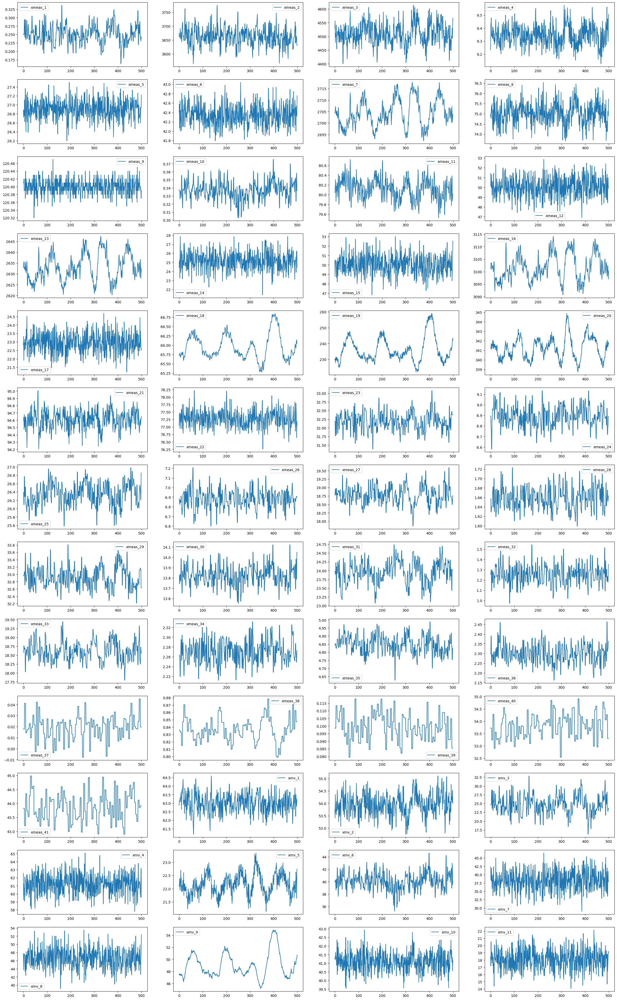

In [8]:
# Filter & Visualize the first simulation run

# Select rows where simulationRun == 1, then drop the first 3 columns (keep columns from index 3 onward)
df_train = df_ff_train[df_ff_train.simulationRun == 1].iloc[:, 3:]

fig, ax = plt.subplots(13, 4, figsize=(30, 50))
# this for loop plots each column of the DataFrame in a separate subplot
# ax.ravel() flattens the 2D array of axes into a 1D array,
for i in range(df_train.shape[1]):
    df_train.iloc[:, i].plot(ax=ax.ravel()[i])
    ax.ravel()[i].legend()

## Visualizing a faulty test set

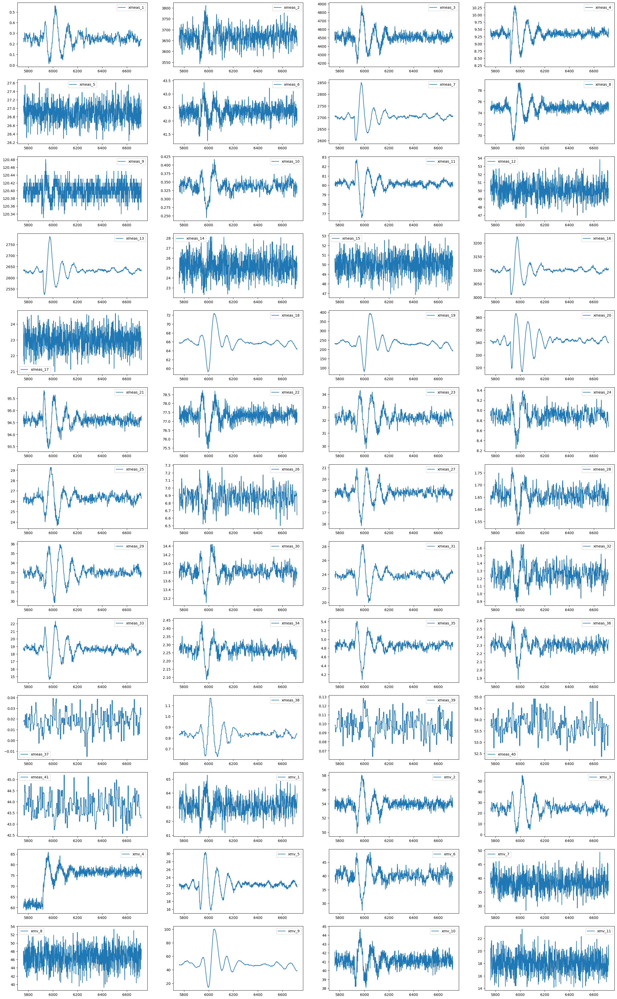

In [9]:
# Select rows where faultNumber == 7 and simulationRun == 1, then drop the first 3 columns (keep columns from index 3 onward)
test_f1_run1 = df_f_test[(df_f_test.faultNumber == 7) & (df_f_test.simulationRun == 1)].iloc[:, 3:]


fig, ax = plt.subplots(13, 4, figsize=(30, 50))

for i in range(test_f1_run1.shape[1]):
    test_f1_run1.iloc[:, i].plot(ax=ax.ravel()[i])
    ax.ravel()[i].legend()

## Visualizing Spearman Correlations

Features that have strong correlations with others will be easier to model with LGB.

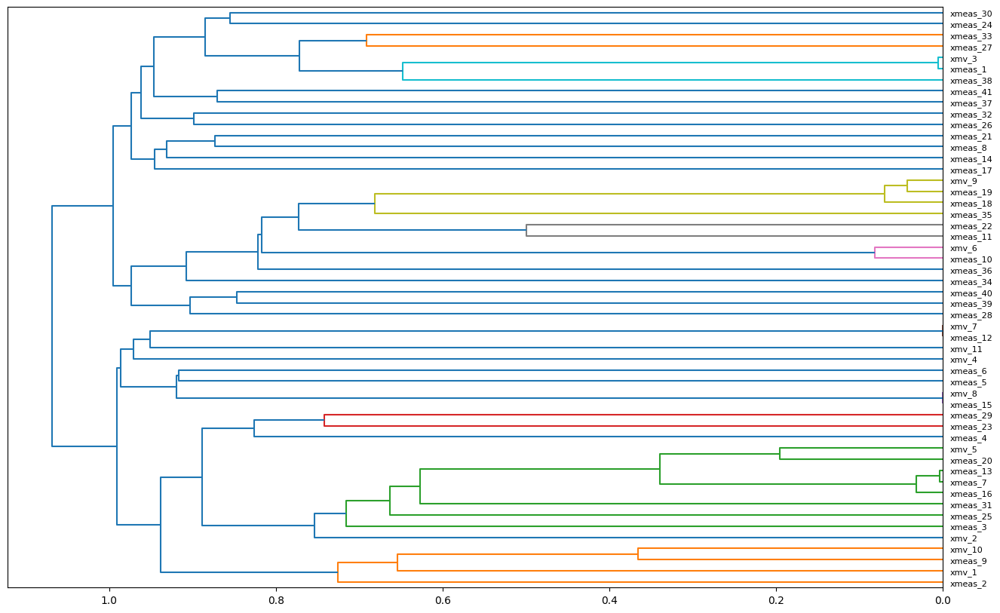

In [10]:
from scipy.cluster import hierarchy as hc

corr = np.round(scipy.stats.spearmanr(df_train).correlation, 4)
corr_condensed = hc.distance.squareform(1 - corr)
z = hc.linkage(corr_condensed, method='average')
fig = plt.figure(figsize=(16, 10))
dendrogram = hc.dendrogram(z,
                           labels=df_train.columns,
                           orientation='left',
                           leaf_font_size=8)
plt.show()

# Training

In the following pictures we have:

* the SPE charts for the two models;
* the explained variance of PCA;
* the LGB predictions of each variable.

Validation and testing were calculated using normal data.

Training model: pca
The shape of the training data: (500, 52) which means 500 samples and 52 features.
Number of components selected: 30
PCA plotting is enabled
Training model: lgb
LGB Ploting is enabled


Text(0.5, 0.98, 'SPE')

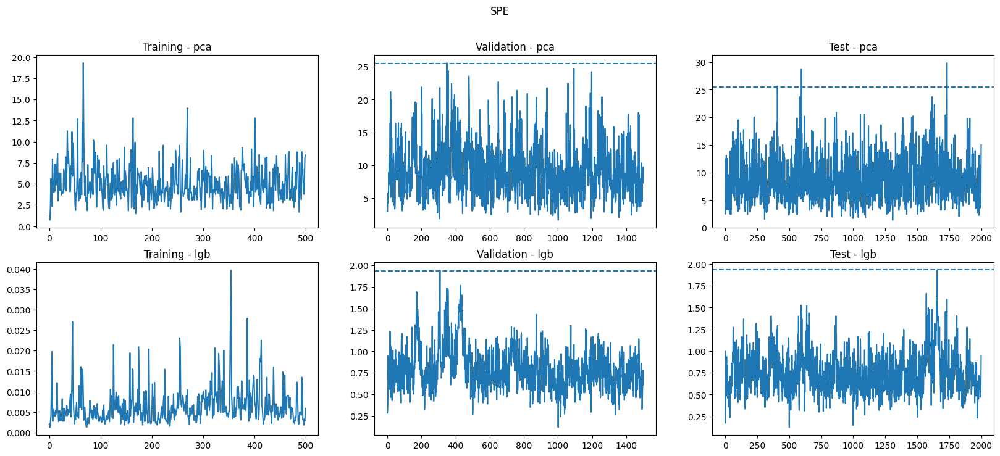

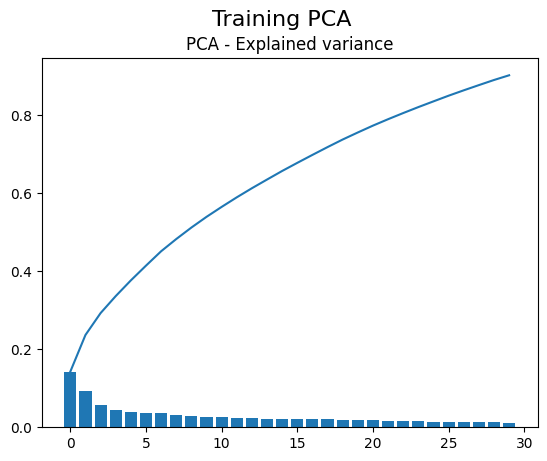

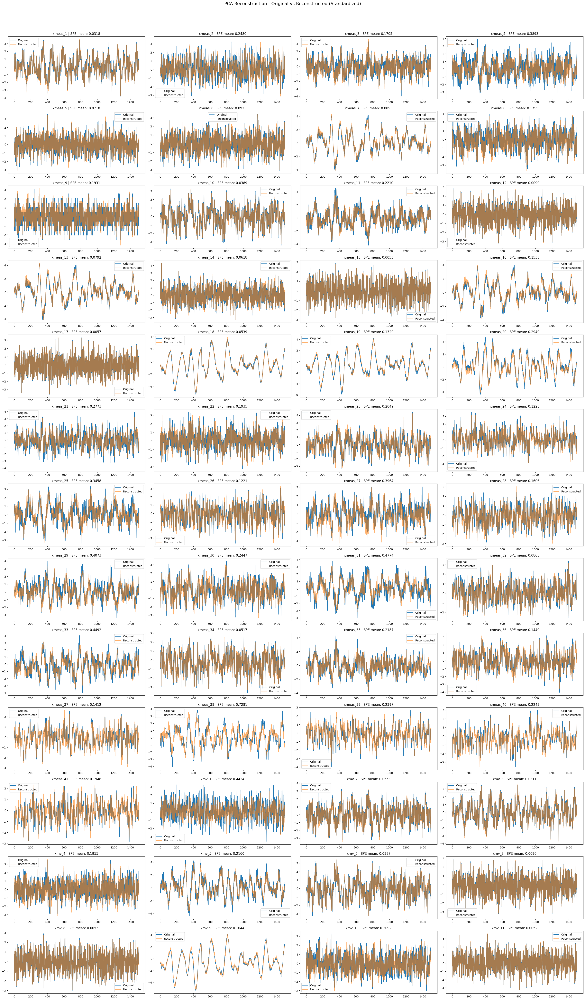

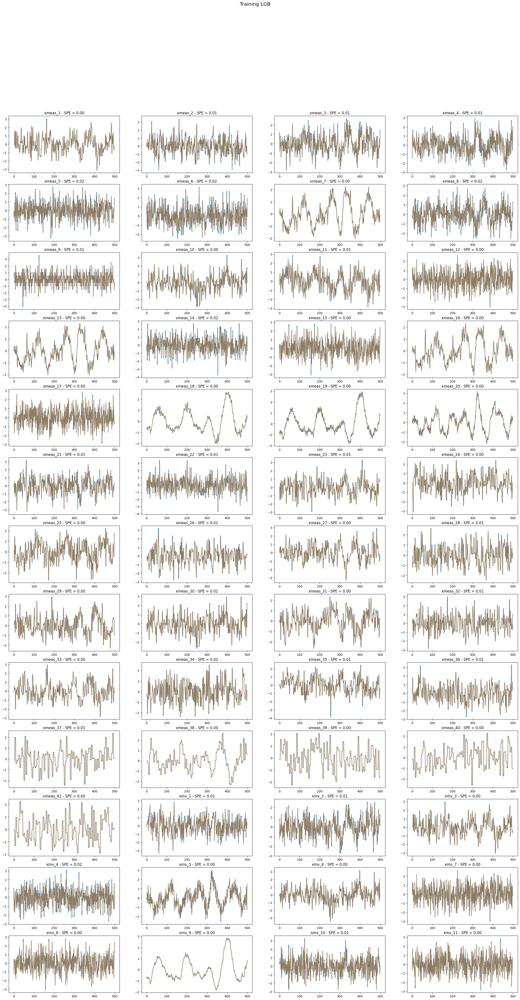

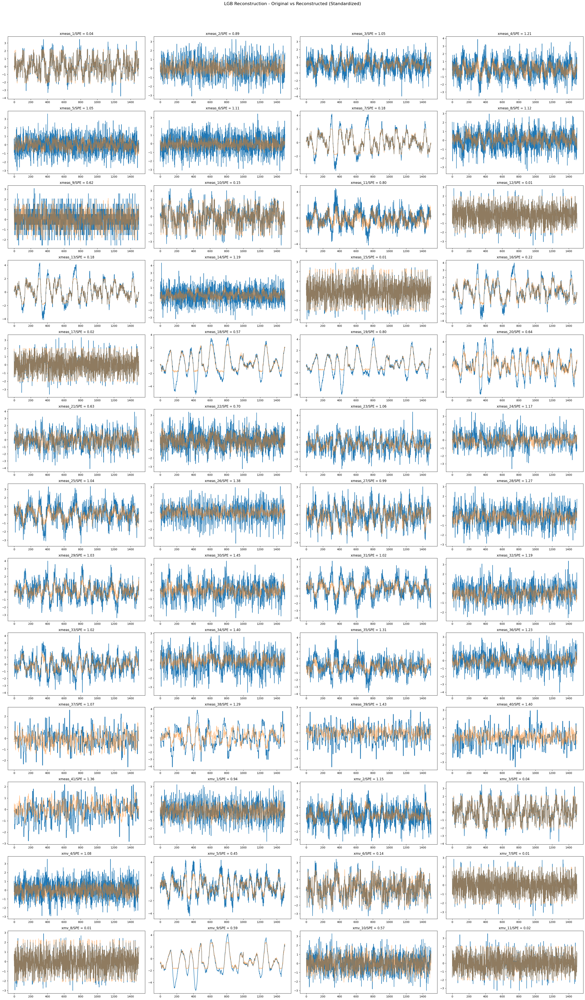

In [28]:
df_train = df_ff_train[df_ff_train.simulationRun ==1].iloc[:, 3:]
df_validation = df_ff_train[(df_ff_train.simulationRun > 1) & (df_ff_train.simulationRun < 5)].iloc[:, 3:]
df_test = df_ff_train[(df_ff_train.simulationRun > 5) & (df_ff_train.simulationRun < 10)].iloc[:, 3:]

reg = lgb.LGBMRegressor

models = {'pca': ModelPCA(), 'lgb': ModelEnsembleRegressors(reg,verbosity=-1)}
detection_limits = {}

# Plot SPE values for each model (PCA and LGB):
#   - Left column: Training SPE
#   - Middle column: Validation SPE with 99.99% threshold line
#   - Right column: Test SPE with same threshold line
# Rows correspond to models ('pca', 'lgb'), columns to datasets

# This line creates a grid of subplots using Matplotlib.
fig, ax = plt.subplots(len(models), 3, figsize=(20, 4 * len(models)))

i = 0
for name, model in models.items():
    print(f"Training model: {name}")
    spe_train = model.train(df_train, plot=True)
    spe_validation = model.test(df_validation, plot=True)
    spe_test = model.test(df_test)

    detection_limits[name] = np.percentile(spe_validation, 99.99)

    ax[i, 0].plot(spe_train)
    ax[i, 1].plot(spe_validation)
    ax[i, 2].plot(spe_test)

    ax[i, 0].set_title(f'Training - {name}')
    ax[i, 1].set_title(f'Validation - {name}')
    ax[i, 2].set_title(f'Test - {name}')

    ax[i, 1].axhline(detection_limits[name], ls='--')
    ax[i, 2].axhline(detection_limits[name], ls='--')

    i += 1

fig.suptitle('SPE')

# Testing (faulty sets)

Here we have a comparison between PCA and LGB. We will print the overall fault detection rate and the results for each fault (tabularly and graphically).

This **detection rate** measures how often the fault is detected once it occurs.

$$
\text{detection rate} = \frac{\text{number of times SPE > limit}}{\text{total number of samples after fault start}}
$$



Testing model: pca
Testing model: lgb
pca    58.99375
lgb    53.25000
dtype: float64


,IDV(1),IDV(2),IDV(3),IDV(4),IDV(5),IDV(6),IDV(7),IDV(8),IDV(9),IDV(10),IDV(11),IDV(12),IDV(13),IDV(14),IDV(15),IDV(16),IDV(17),IDV(18),IDV(19),IDV(20)
pca,99.625,98.0,0.75,87.25,15.625,100.0,99.25,96.75,0.75,12.250,37.375,96.375,90.5,99.875,0.875,22.625,81.625,92.5,2.625,45.250
lgb,99.250,98.0,0.00,16.75,24.000,100.0,100.00,97.50,0.00,7.125,28.625,96.750,90.0,99.750,0.000,9.625,73.750,92.0,0.000,31.875


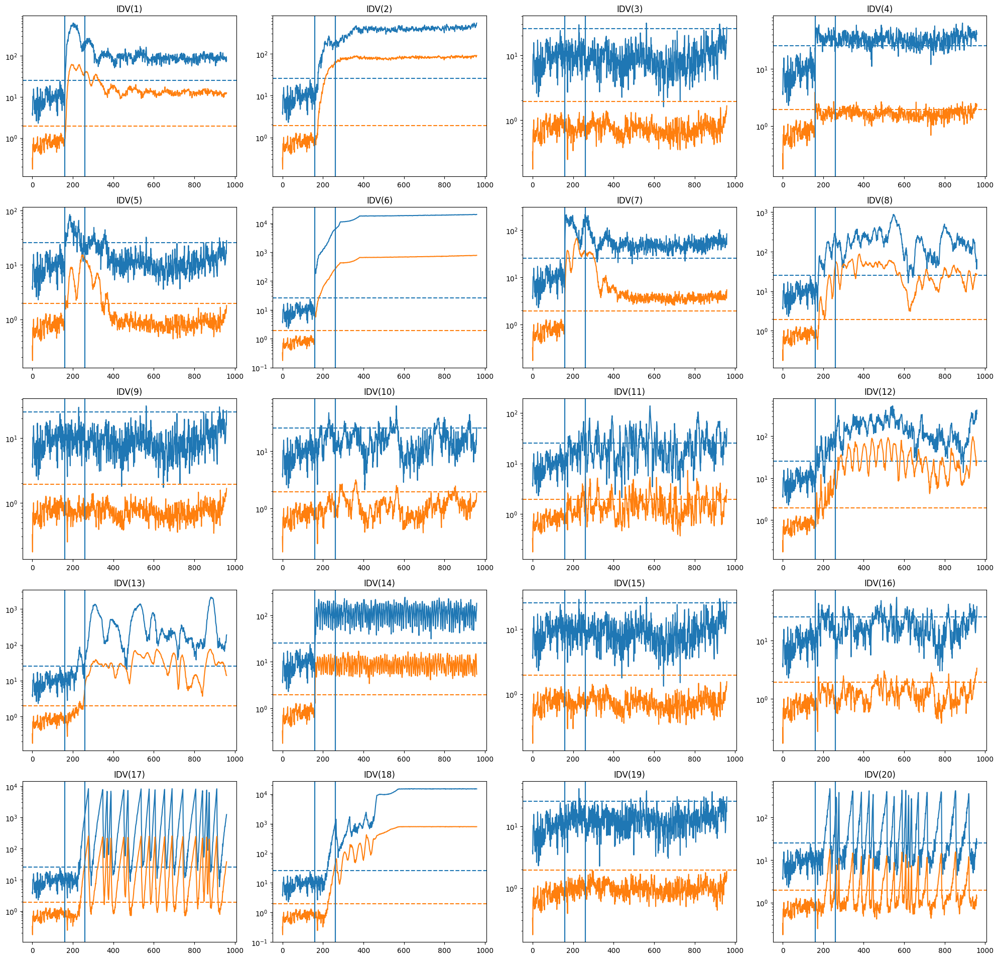

In [30]:
# Create 5 rows and 4 columns of subplots for each IDV (1 to 20)
fig, ax = plt.subplots(5, 4, figsize=(20, 20))

# Create empty DataFrame with row labels IDV(1) to IDV(20)
# False detection rate (FDR)
fdr_df = pd.DataFrame(index=[f'IDV({i})' for i in range(1, 21)])

for name, model in models.items():
    print(f"Testing model: {name}")
    # this will be a list of lists
    spe_test = []
    fdr = []

    for i in range(20):
        # Filter rows for fault i+1 and simulationRun 1, then select columns from 4th onward.
        df_test = df_f_test[(df_f_test.faultNumber == i + 1)
                            & (df_f_test.simulationRun == 1)].iloc[:, 3:]
        results = model.test(df_test)
        spe_test.append(results)

        # The process starts normally (in control) for ~8 hours (~160 samples)
        # Since the sampling interval is 3 minutes, 1 hour → 60 / 3 = 20 samples. For datasets with 500 total samples (25 hours), that initial 20 samples (or 160 if scaled to 48h) are fault-free.
        fault_occurrence = len(spe_test[i]) // 6
       
        # Add how often SPE is above limit after fault starts
        post_fault_spe = spe_test[i][fault_occurrence:]  #  SPE values after the fault starts
        above_limit = post_fault_spe > detection_limits[name]  # Boolean array where values exceed the detection limit
        fdr_value = np.mean(above_limit)  # detection rate
        fdr.append(fdr_value)

        color = ax.ravel()[i]._get_lines.get_next_color()
        ax.ravel()[i].plot(np.arange(len(spe_test[i])),
                           spe_test[i],
                           color=color)
        ax.ravel()[i].axhline(detection_limits[name], ls='--', color=color)
        ax.ravel()[i].axvline(fault_occurrence)
        ax.ravel()[i].axvline(fault_occurrence + 100)
        ax.ravel()[i].set_title(f'IDV({i+1})')
        ax.ravel()[i].set_yscale('log')

    fdr_df[name] = fdr

print(100 * fdr_df.mean())
100 * fdr_df.T

The PCA model is superior.

# Adding lag variables

Here, this strategy will only be used with PCA (in this case, the technique is called Dynamical PCA, or DPCA).

The shape of the training data: (499, 104) which means 499 samples and 104 features.
Number of components selected: 48
The shape of the training data: (498, 156) which means 498 samples and 156 features.
Number of components selected: 64
The shape of the training data: (497, 208) which means 497 samples and 208 features.
Number of components selected: 78
pca_lag1    60.631250
pca_lag2    59.755945
pca_lag3    60.469925
dtype: float64


,IDV(1),IDV(2),IDV(3),IDV(4),IDV(5),IDV(6),IDV(7),IDV(8),IDV(9),IDV(10),IDV(11),IDV(12),IDV(13),IDV(14),IDV(15),IDV(16),IDV(17),IDV(18),IDV(19),IDV(20)
pca_lag1,99.625000,97.750000,0.0,100.0,9.875000,100.0,100.0,95.625000,0.0,13.250000,66.750000,95.750000,89.625000,97.500000,0.0,20.875000,84.250000,92.500000,3.250000,46.000000
pca_lag2,99.624531,97.747184,0.0,100.0,6.132666,100.0,100.0,95.744681,0.0,7.008761,66.207760,95.744681,90.237797,99.249061,0.0,14.392991,83.479349,92.490613,0.250313,46.808511
pca_lag3,99.749373,97.744361,0.0,100.0,6.892231,100.0,100.0,96.741855,0.0,8.145363,70.551378,97.117794,90.977444,100.000000,0.0,16.040100,84.210526,92.606516,0.250627,48.370927


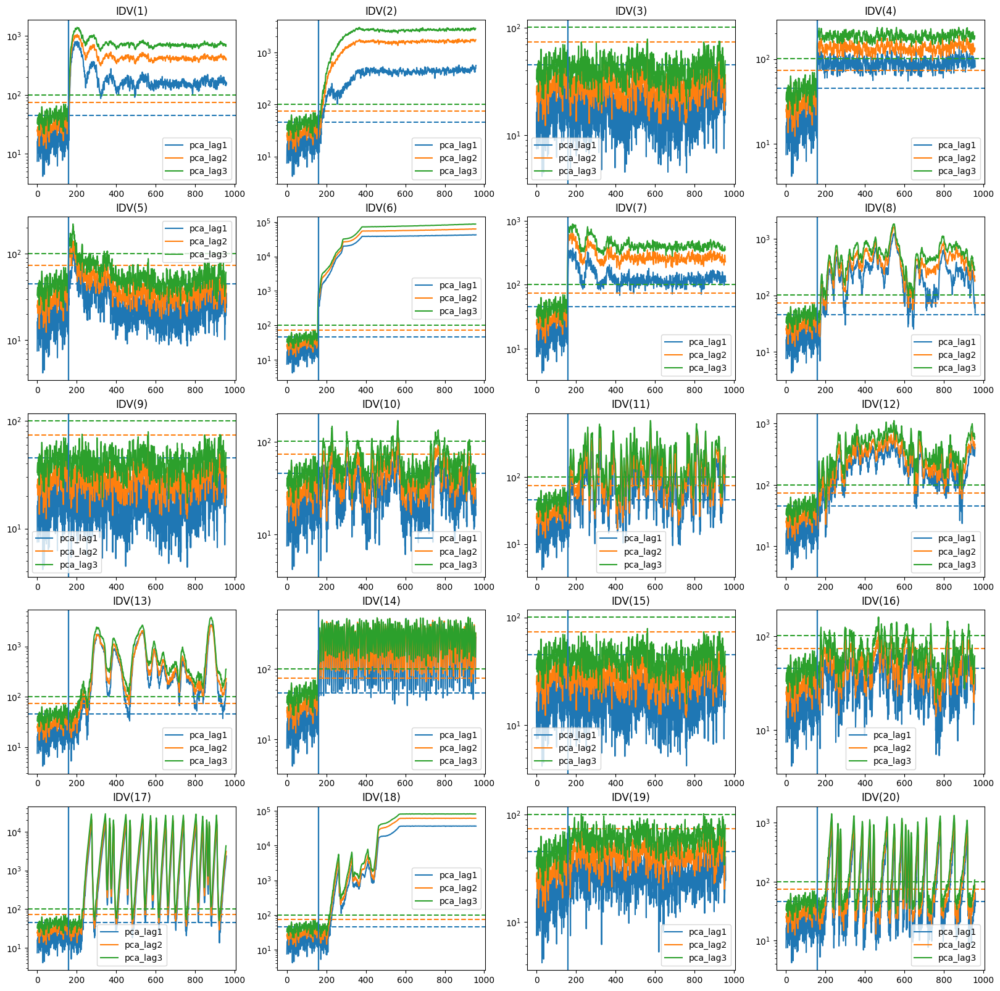

In [13]:
fig, ax = plt.subplots(5, 4, figsize=(20, 20))

df_train = df_ff_train[df_ff_train.simulationRun ==1].iloc[:, 3:]
df_validation = df_ff_train[(df_ff_train.simulationRun > 1)& (df_ff_train.simulationRun < 5)].iloc[:, 3:]

models = {
    'pca_lag1': ModelPCA(),
    'pca_lag2': ModelPCA(),
    'pca_lag3': ModelPCA()
}
lags = {'pca_lag1': 1, 'pca_lag2': 2, 'pca_lag3': 3}

detection_limits = {}

fdr_df = pd.DataFrame(index=[f'IDV({i})' for i in range(1, 21)])

for name, model in models.items():

    spe_test = []
    fdr = []

    _ = model.train(apply_lag(df_train, lags[name]))
    spe_validation = model.test(apply_lag(df_validation, lags[name]))
    detection_limits[name] = np.percentile(spe_validation, 99.99)

    for i in range(20):

        df_test = apply_lag(
            df_f_test[
                (df_f_test.faultNumber == i + 1)
                & (df_f_test.simulationRun == 1)].iloc[:, 3:],
            lags[name])

        spe_test.append(model.test(df_test))
        #The process starts normally (in control) for ~8 hours (~160 samples)
        fault_occurrence = len(spe_test[i]) // 6

        fdr.append(np.mean(spe_test[i][fault_occurrence:] > detection_limits[name]))

        color = ax.ravel()[i]._get_lines.get_next_color()
        ax.ravel()[i].plot(np.arange(len(spe_test[i])),
                           spe_test[i],
                           color=color,
                           label=name)
        ax.ravel()[i].axhline(detection_limits[name], ls='--', color=color)
        ax.ravel()[i].axvline(fault_occurrence)
        ax.ravel()[i].set_title(f'IDV({i+1})')
        ax.ravel()[i].set_yscale('log')
        ax.ravel()[i].legend()

    fdr_df[name] = fdr

print(100 * fdr_df.mean())
100 * fdr_df.T

Although the overall performance does not increase, some cases benefit from the technique, especially the faults 11 and 14.

## Filtering noise

Three window sizes will be evaluated: 10, 50 and 100. 

### Filtering noise for PCA

The shape of the training data: (490, 52) which means 490 samples and 52 features.
Number of components selected: 19
The shape of the training data: (450, 52) which means 450 samples and 52 features.
Number of components selected: 9
The shape of the training data: (400, 52) which means 400 samples and 52 features.
Number of components selected: 7
WS_10     59.700
WS_50     60.400
WS_100    59.775
dtype: float64


,IDV(1),IDV(2),IDV(3),IDV(4),IDV(5),IDV(6),IDV(7),IDV(8),IDV(9),IDV(10),IDV(11),IDV(12),IDV(13),IDV(14),IDV(15),IDV(16),IDV(17),IDV(18),IDV(19),IDV(20)
WS_10,99.250,98.125,0.0,99.75,46.625,99.875,99.750,97.375,0.0,6.125,80.000,98.500,94.25,35.375,0.0,3.25,90.125,92.875,0.500,52.250
WS_50,98.375,97.125,0.0,99.25,98.375,99.125,99.375,96.375,0.0,0.125,77.250,86.125,94.00,0.000,0.0,0.00,89.875,91.375,0.125,81.125
WS_100,98.250,96.125,0.0,98.75,97.125,98.875,99.000,94.375,0.0,0.000,64.625,83.750,93.00,0.000,0.0,0.00,89.750,90.250,0.125,91.500


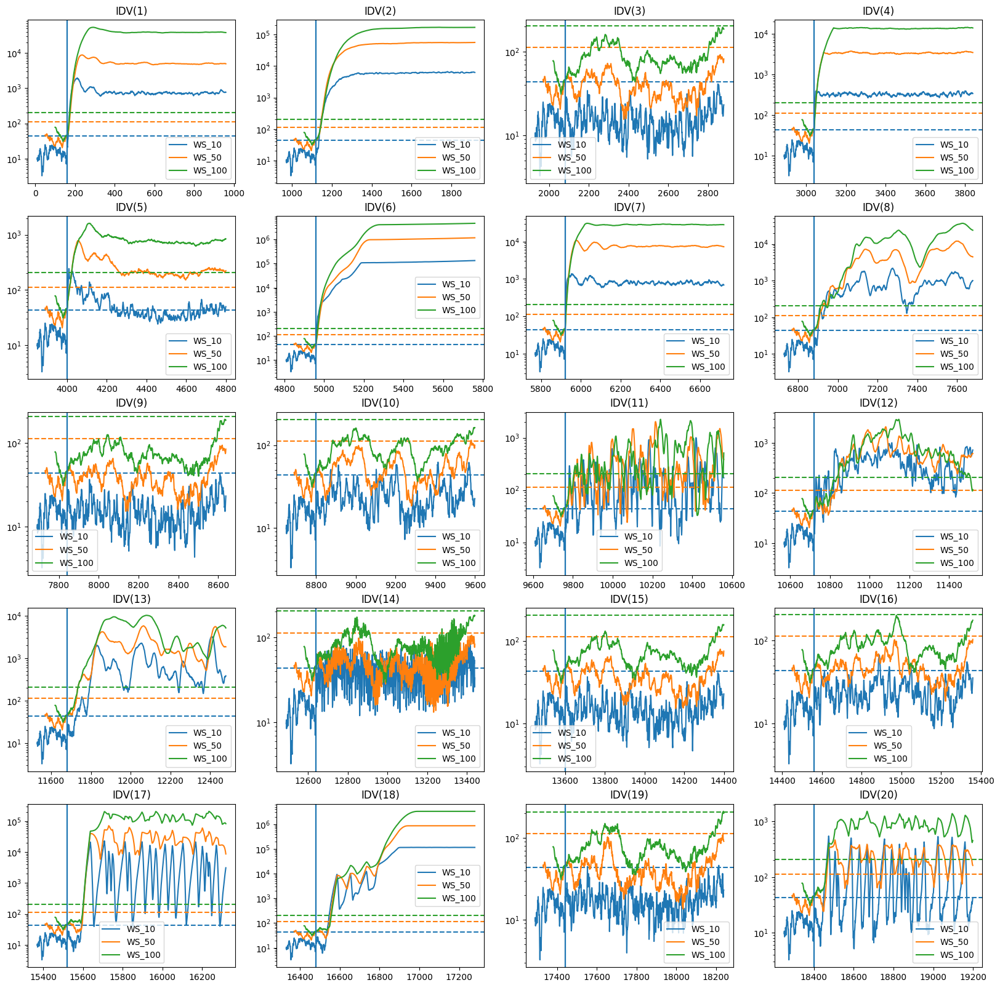

In [14]:
fig, ax = plt.subplots(5, 4, figsize=(20, 20))

df_train = df_ff_train[df_ff_train.simulationRun ==1].iloc[:, 3:]
df_validation = df_ff_train[(df_ff_train.simulationRun > 1)& (df_ff_train.simulationRun < 5)].iloc[:, 3:]

models = {'WS_10': ModelPCA(), 'WS_50': ModelPCA(), 'WS_100': ModelPCA()}
WS = {'WS_10': 10, 'WS_50': 50, 'WS_100': 100}

detection_limits = {}

fdr_df = pd.DataFrame(index=[f'IDV({i})' for i in range(1, 21)])

for name, model in models.items():

    spe_test = []
    fdr = []

    _ = model.train(filter_noise_ma(df_train, WS[name]))
    spe_validation = model.test(filter_noise_ma(df_validation, WS[name]))
    detection_limits[name] = np.percentile(spe_validation, 99.99)

    for i in range(20):

        df_test = filter_noise_ma(
            df_f_test[
                (df_f_test.faultNumber == i + 1)
                & (df_f_test.simulationRun == 1)].iloc[:, 3:],
            WS[name])

        spe_test.append(model.test(df_test))

        fault_occurrence = df_test.index[0] - WS[name] + 160

        fdr.append(
            np.mean(spe_test[i][160 - WS[name]:] > detection_limits[name]))

        color = ax.ravel()[i]._get_lines.get_next_color()
        ax.ravel()[i].plot(df_test.index, spe_test[i], color=color, label=name)
        ax.ravel()[i].axhline(detection_limits[name], ls='--', color=color)
        ax.ravel()[i].axvline(fault_occurrence)  #, color = color)
        ax.ravel()[i].set_title(f'IDV({i+1})')
        ax.ravel()[i].set_yscale('log')
        ax.ravel()[i].legend()

    fdr_df[name] = fdr

print(100 * fdr_df.mean())
100 * fdr_df.T

### Filtering noise for LGB

WS_10     55.5125
WS_50     58.9125
WS_100    59.0625
dtype: float64


,IDV(1),IDV(2),IDV(3),IDV(4),IDV(5),IDV(6),IDV(7),IDV(8),IDV(9),IDV(10),IDV(11),IDV(12),IDV(13),IDV(14),IDV(15),IDV(16),IDV(17),IDV(18),IDV(19),IDV(20)
WS_10,98.875,98.00,0.0,99.625,28.000,99.750,99.625,97.125,0.0,5.375,67.250,97.750,93.750,9.0,0.0,3.125,85.125,92.375,0.0,35.500
WS_50,98.250,96.75,0.0,98.875,97.625,99.000,99.250,95.250,0.0,2.750,68.125,84.750,93.375,0.0,0.0,0.000,89.625,90.875,0.0,63.750
WS_100,98.000,95.75,0.0,98.500,96.750,98.875,99.000,93.625,0.0,0.000,55.125,82.625,92.125,0.0,0.0,0.000,89.625,90.125,0.0,91.125


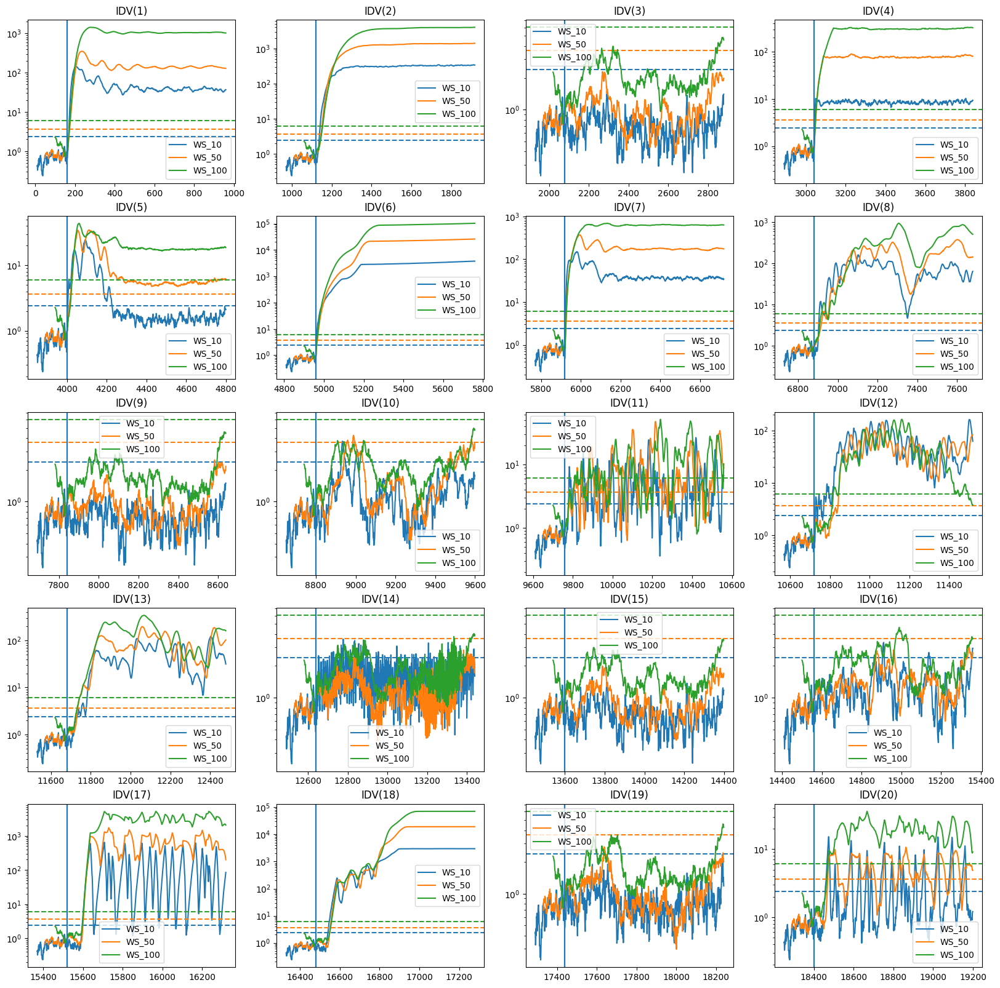

In [15]:
fig, ax = plt.subplots(5, 4, figsize=(20, 20))

df_train = df_ff_train[df_ff_train.simulationRun ==1].iloc[:, 3:]
df_validation = df_ff_train[(df_ff_train.simulationRun > 1) & (df_ff_train.simulationRun < 5)].iloc[:, 3:]

reg = lgb.LGBMRegressor

models = {
    'WS_10': ModelEnsembleRegressors(reg,verbosity=-1),
    'WS_50': ModelEnsembleRegressors(reg,verbosity=-1),
    'WS_100': ModelEnsembleRegressors(reg,verbosity=-1)
}
WS = {'WS_10': 10, 'WS_50': 50, 'WS_100': 100}

detection_limits = {}

fdr_df = pd.DataFrame(index=[f'IDV({i})' for i in range(1, 21)])

for name, model in models.items():

    spe_test = []
    fdr = []

    _ = model.train(filter_noise_ma(df_train, WS[name]))
    spe_validation = model.test(filter_noise_ma(df_validation, WS[name]))
    detection_limits[name] = np.percentile(spe_validation, 99.99)

    for i in range(20):

        df_test = filter_noise_ma(
            df_f_test[
                (df_f_test.faultNumber == i + 1)
                & (df_f_test.simulationRun == 1)].iloc[:, 3:],
            WS[name])

        spe_test.append(model.test(df_test))

        fault_occurrence = df_test.index[0] - WS[name] + 160

        fdr.append(
            np.mean(spe_test[i][160 - WS[name]:] > detection_limits[name]))

        #color = next(ax.ravel()[i]._get_lines.prop_cycler)['color']
        color = ax.ravel()[i]._get_lines.get_next_color()
        ax.ravel()[i].plot(df_test.index, spe_test[i], color=color, label=name)
        ax.ravel()[i].axhline(detection_limits[name], ls='--', color=color)
        ax.ravel()[i].axvline(fault_occurrence)  #, color = color)
        ax.ravel()[i].set_title(f'IDV({i+1})')
        ax.ravel()[i].set_yscale('log')
        ax.ravel()[i].legend()

    fdr_df[name] = fdr

print(100 * fdr_df.mean())
100 * fdr_df.T

It is noticed that, in the global measure, the PCA model is not affected, although there is a significant improvement specifically in relation to faults 5 and 20.

Regarding the LGB model, there is an improvement in the overall performance that makes it reach fault detection rates similar to those of the PCA.

# Conclusions

* PCA and LGB can detect faults in Tennesse Eastman Processes.
* Some faults are easier to detect than others.
* In general, PCA is superior to LGB.
* Some faults are easier to detect when pre-processing techniques are applied.
* LGB benefits from noise filtering, achieving performances comparable to vanilla PCA.